# YOLOv8 and YOLOv7 Comparison
This notebook is used for training the models, performing Structural Crack Detection and Evaluating the YOLOv7 metrics like:
* Training Results
* F1_Score
* Precision and Recall 
* Confusion Matrix (Only for 10 Epochs)

It follows the same format as the YOLOv8 notebook so an easier comparison can be between the notebooks. However, this notebook differs from the YOLOv8 as it is also going to be used to compare the results between YOLOv7 and YOLOv8 giving a better understanding which model performs better in terms of accuracy, efficiency and scalability.


## Enviroment Setup
Enviroment Setup for YOLOv7 is using the same environment that the YOLO
v8 notebook used. For Enviromnet setup the only thing to do is to check if CUDA is using GPU and to also make sure that the environment is in the yolov7 directory.


* Having an isolated enviroment and python notebooks between each model helps keep it seperate from other projects and allows YOLOv7 have its own dependicies.


In [2]:
#This shows that YOLOv7 can now train on the GPU and the enviroment is offically set up.
import torch

# Check if CUDA (GPU support) is available
if torch.cuda.is_available():
    # Get the number of available GPUs
    print(torch.cuda.device_count(), "GPU(s) available.")
    # Print the name of the current GPU
    print("GPU:", torch.cuda.get_device_name(0))
else:
    print("CUDA is not available. Training will be performed on CPU.")

1 GPU(s) available.
GPU: NVIDIA GeForce GTX 1080 Ti


In [14]:
from IPython.display import Image
import tensorboard


In [2]:
%cd yolov7/

c:\00FinalYearProject\yolov7


c:\Users\aaron\.conda\envs\myenv\Lib\site-packages\IPython\core\magics\osm.py:417: UserWarning: using dhist requires you to install the `pickleshare` library.
  self.shell.db['dhist'] = compress_dhist(dhist)[-100:]


## 1 EPOCH Training
Training 1 epoch is just to test the time it takes to train the YOLOv7 model. Here are the results from training YOLOv7 on 1 epoch:

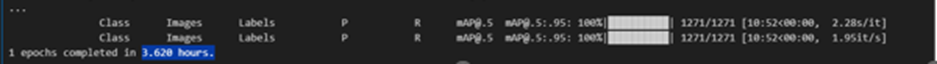

1 Epoch competed in 3.62 hours which is longer than YOLOv8 took which was 1.573 hours. This means that per epoch YOLOv7 takes over double the time to train. This leads to more constraints on how many epochs that can be used when training.

I've Decided to go up in increments of 5 as it is good to see if the model is learning while also not taking to long for the model to train when going up in increments of 5. Hopefully going up in increments of 5 will eventually let the model meet convergence.

## 1 EPOCH Structural Crack Detection

In [24]:
!python detect.py --weights "C:/00FinalYearProject/yolov7/runs/train/YOLOv7 1 Epoch Training Results/weights/best.pt" --conf 0.70 --img-size 1280  --source "C:/Users/aaron/OneDrive/Desktop/test_images" --name detection

Namespace(weights=['C:/00FinalYearProject/yolov7/runs/train/YOLOv7 1 Epoch Training Results/weights/best.pt'], source='C:/Users/aaron/OneDrive/Desktop/test_images', img_size=1280, conf_thres=0.7, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='detection', exist_ok=False, no_trace=False)
Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

2 Structural Cracks, Done. (59.9ms) Inference, (42.4ms) NMS
 The image with the result is saved in: runs\detect\detection\MICA Crack detection 1.jpg
1 No Structural Crack, 1 Structural Crack, Done. (51.6ms) Inference, (1.4ms) NMS
 The image with the result is saved in: runs\detect\detection\MICA Crack detection 2.jpg
Done. (54.7ms) Inference, (0.0ms) NMS
 The image with the result is saved in: 

YOLOR  v0.1-128-ga207844 torch 2.2.0+cu118 CUDA:0 (NVIDIA GeForce GTX 1080 Ti, 11263.875MB)

c:\Users\aaron\.conda\envs\myenv\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ..\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Model Summary: 306 layers, 36485311 parameters, 6194944 gradients, 103.2 GFLOPS


* I've set the confidence to 70 as the detections before on lower confidence intervals were picking up to much noice that wasn't relevent with crack detection. 
* The image size is set to 1280 as it is the default from git hub code, I tried changing it but didn't change anything overall the detections were still the same.

YOLOv7 performed crack detection at an effective speed, but it is not consistent in its detections.  Compared to the YOLOv8 1 epoch model, it performs crack detection slightly slower overall, but it is still in the milliseconds which means the model falls under the 3 second detection mark.  The model picked detections in the first 4 images, but missed out on detection on the last images, indicating that the model is sensitive and has plenty to improve on when performing crack detection.

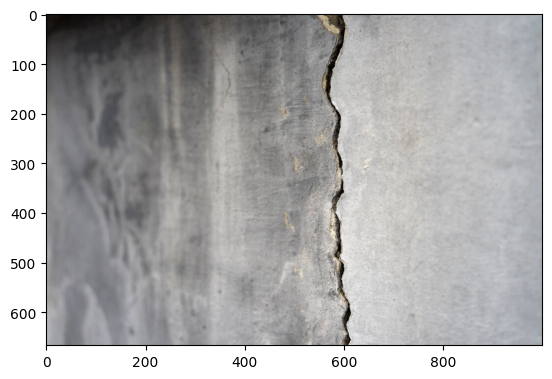

In [1]:
from matplotlib import pyplot as plt
from PIL import Image

img = Image.open('C:/00FinalYearProject/yolov7/runs/detect/1 Epoch Detection YOLOv7/crack1.jpg')
plt.imshow(img)
plt.axis('off')
plt.show()

# The image where crack detection was not performed. This image did not fall under either non-structural crack and structural crack.
# Indicating that the model is still sensitive at hogher confidence intervals meaning it would not perform the detection.


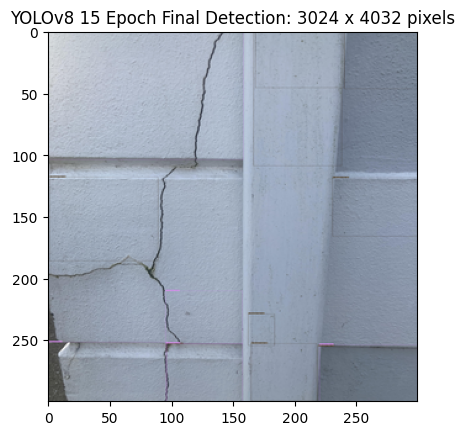

In [2]:
from PIL import Image
import matplotlib.pyplot as plt

img = Image.open('C:/00FinalYearProject/yolov7/runs/detect/1 Epoch Detection YOLOv7/MICA Crack detection 1.jpg')
size = (300, 300)

resized_img = img.resize(size, Image.Resampling.LANCZOS)
plt.imshow(resized_img)
plt.title(f'YOLOv8 15 Epoch Final Detection: {img.size[0]} x {img.size[1]} pixels')  
plt.axis('off')
plt.show()

#The detections are very small and hard to make out. This can be because the model is training on small images meaning it will make small detections.
# It can also mean that the model is overfitting and detecting noise meaning it makes a lot of small detections.
# To try fix this, image size was adjusted but it gave an error when the image size was changed.

## 1 EPOCH Results and Evaluation


### F1 Score and Confidence Curve

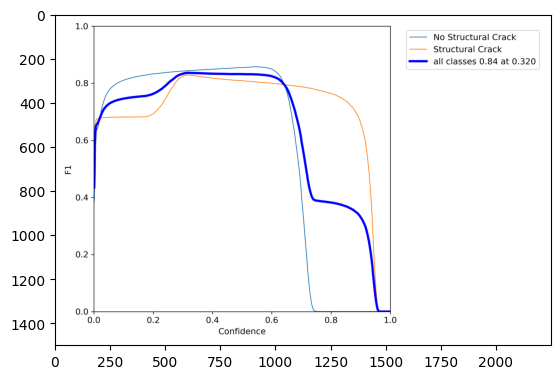

In [22]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/train/YOLOv7 1 Epoch Training Results/F1_curve.png')
plt.imshow(img)
plt.axis('off')
plt.show()

### F1 Curve Evaluation and Comparision
1 EPOCH performs good with all classes being at there best performance at 0.84 F1-score when the confidence interval is at 0.32. This is higher than the YOLOv8 model(0.82 F1 Score at 0.32 Confidence Interval) when training on 1 Epoch. This indicates that the model performs better when it comes to F1-score.

### Precision and Recall Curve

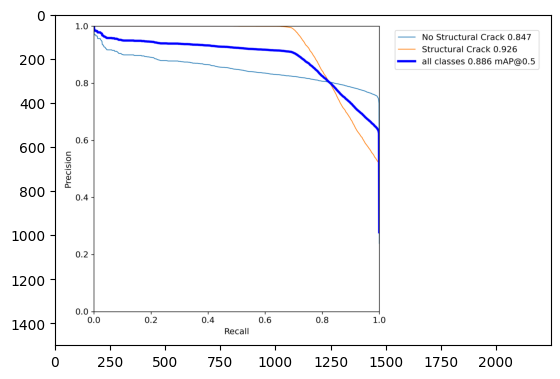

In [25]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/train/YOLOv7 1 Epoch Training Results/PR_curve.png')
plt.imshow(img)
plt.axis('off')
plt.show()

### PR Curve Evaluation
Here is the formula for Recall so understanding the graph above can be easier to understand:

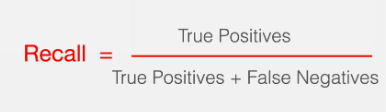


The presision stays very high across all recalls for all classes and drops off for all classes at around 0.7 recall for Structural Crack and All classes but for No Strucural Crack class it drops off at a slow decent until 1.0 recall. Overall the model performs precision well over most of the recall. 

## 5 EPOCH Training 

In [12]:
!python train.py --batch-size 10 --img 640 640 --data E:/FinalYearProject.v3i.yolov7pytorch/data.yaml --weights yolov7.pt --device 0 --epochs 5

wandb: Install Weights & Biases for YOLOR logging with 'pip install wandb' (recommended)

autoanchor: Analyzing anchors... anchors/target = 2.00, Best Possible Recall (BPR) = 1.0000
                 all       30491       30491       0.838       0.866       0.883       0.882
                 all       30491       30491       0.826       0.871       0.882       0.794
                 all       30491       30491       0.818       0.871       0.885       0.767
                 all       30491       30491       0.819       0.866       0.884       0.729
                 all       30491       30491       0.814       0.872       0.886       0.788
 No Structural Crack       30491       14704       0.697           1       0.848       0.763
    Structural Crack       30491       15787       0.931       0.745       0.924       0.812
Optimizer stripped from runs\train\exp5\weights\last.pt, 74.8MB
Optimizer stripped from runs\train\exp5\weights\best.pt, 74.8MB


YOLOR  v0.1-128-ga207844 torch 2.2.0+cu118 CUDA:0 (NVIDIA GeForce GTX 1080 Ti, 11263.875MB)

Namespace(weights='yolov7.pt', cfg='', data='E:/FinalYearProject.v3i.yolov7pytorch/data.yaml', hyp='data/hyp.scratch.p5.yaml', epochs=5, batch_size=10, img_size=[640, 640], rect=False, resume=False, nosave=False, notest=False, noautoanchor=False, evolve=False, bucket='', cache_images=False, image_weights=False, device='0', multi_scale=False, single_cls=False, adam=False, sync_bn=False, local_rank=-1, workers=8, project='runs/train', entity=None, name='exp', exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias='latest', freeze=[0], v5_metric=False, world_size=1, global_rank=-1, save_dir='runs\\train\\exp5', total_batch_size=10)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup

       3/4     8.51G  0.005039  0.003582  0.005943   0.01456        40       640:  92%|█████████▏| 19590/21349 [3:06:06<16:46,  1.75it/s]
       3/4     8.51G  0.005039  0.003582  0.005943   0.01456        25       640:  92%|█████████▏| 19590/21349 [3:06:07<16:46,  1.75it/s]
       3/4     8.51G  0.005039  0.003582  0.005943   0.01456        25       640:  92%|█████████▏| 19591/21349 [3:06:07<16:42,  1.75it/s]
       3/4     8.51G  0.005039  0.003582  0.005943   0.01456        36       640:  92%|█████████▏| 19591/21349 [3:06:07<16:42,  1.75it/s]
       3/4     8.51G  0.005039  0.003582  0.005943   0.01456        36       640:  92%|█████████▏| 19592/21349 [3:06:07<16:41,  1.75it/s]
       3/4     8.51G  0.005039  0.003582  0.005942   0.01456        31       640:  92%|█████████▏| 19592/21349 [3:06:08<16:41,  1.75it/s]
       3/4     8.51G  0.005039  0.003582  0.005942   0.01456        31       640:  92%|█████████▏| 19593/21349 [3:06:08<16:39,  1.76it/s]
       3/4     8.51G  0.005038  0.

Batch size stays at 10 for now but will probably reduced when more epochs are done due to the training time being very long. Image size also stays the same for now even with training taking longer its better for the model to train on more batches and bigger image sizes.

## 5 EPOCH Structural Crack Detection

In [29]:
!python detect.py --weights "C:/00FinalYearProject/yolov7/runs/train/YOLOv7 5 Epoch Training Results/weights/best.pt" --conf 0.30 --img-size 1280 --source "C:/Users/aaron/OneDrive/Desktop/Detection Videos and Images" --name detection

Namespace(weights=['C:/00FinalYearProject/yolov7/runs/train/YOLOv7 5 Epoch Training Results/weights/best.pt'], source='C:/Users/aaron/OneDrive/Desktop/Detection Videos and Images', img_size=1280, conf_thres=0.3, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='detection', exist_ok=False, no_trace=False)
Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

2 Structural Cracks, Done. (64.6ms) Inference, (53.7ms) NMS
 The image with the result is saved in: runs\detect\detection2\Detection Image 1.jpg
Done. (55.4ms) Inference, (0.0ms) NMS
 The image with the result is saved in: runs\detect\detection2\Detection Image 2.jpg
Done. (55.9ms) Inference, (1.0ms) NMS
 The image with the result is saved in: runs\detect\detection2\Detection Im

YOLOR  v0.1-128-ga207844 torch 2.2.0+cu118 CUDA:0 (NVIDIA GeForce GTX 1080 Ti, 11263.875MB)

c:\Users\aaron\.conda\envs\myenv\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ..\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Model Summary: 306 layers, 36485311 parameters, 6194944 gradients, 103.2 GFLOPS


I dropped the confidence interval to 30 for this one as when the detections were done before on higher it was hard to pick up the detections because they were so small. So the idea was to let more detections happen so maybe more can be visable.

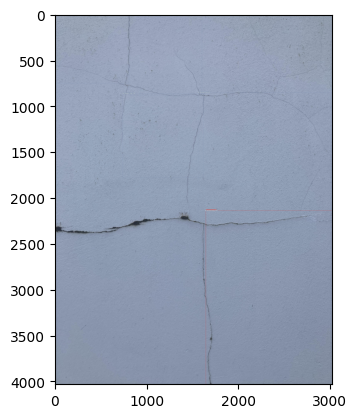

In [27]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/detect/5 Epoch Detection YOLOv7/MICA Crack detection 5.jpg')
plt.imshow(img)
plt.axis('off')
plt.show()

## 5 EPOCH Results and Evaluation

### Training Results

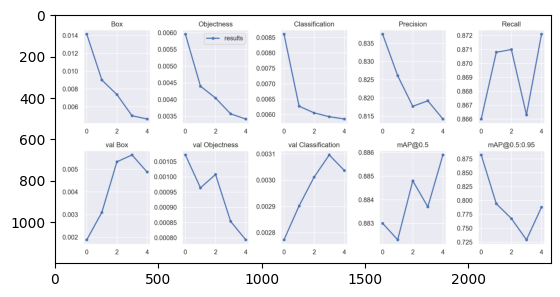

In [3]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/train/YOLOv7 5 Epoch Training Results/results.png')
plt.imshow(img)
plt.axis('off')
plt.show()

### Training Results Evaluation
The results of the training show how well the YOLOv7 5 epoch model performed when training. For loss metrics Box Loss, Objectness Loss and Classification Loss all show a decrease meaning all the loss metrics are indicate that the model is getting better over the models training period. For the performance metrics Precision shows a decrease meaning the model is starting to make more false positive errors as the training progresses. The recall us also decreasing indicating that the model is volatile. This could be because the model is possibly overfitting are the model could be learning to generalize which can lead to the detections to be inaccurate.  The mAP@0.5 stays mainly stable with a slight increase over the epochs and for mAP@0.5:0.95   there is a drop off but at around the 3 epoch it begins to increase again. For both mAP metrics they suggest the model is improving but not at a consistent pace. 





### F1 Score and Confidence Curve

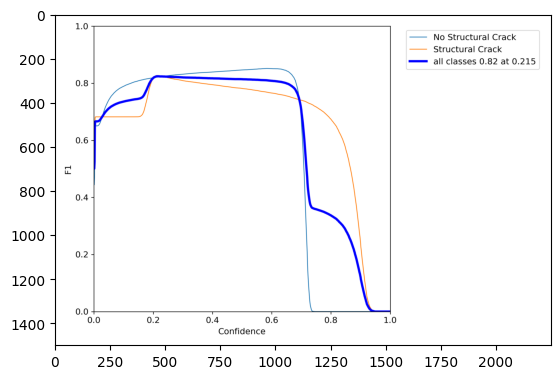

In [30]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/train/YOLOv7 5 Epoch Training Results/F1_curve.png')
plt.imshow(img)
plt.show()

### F1 Score Results Evalaution and Comparsion
The F1 Confidence Curve suggests that the model maintains high F1-scores across a wide range of confidence thresholds for all classes. The aggregated F1=score for all classes peaks at 0.82 with a confidence level of 0.215. Compared to the YOLOv7 model on 1 epoch it seems that the F1-Confidence Curve I slightly worse in terms of peak F1-Confidence but overall performs similar to the 1 Epoch F1 Confidence Curve.


### Precision and Recall Curve

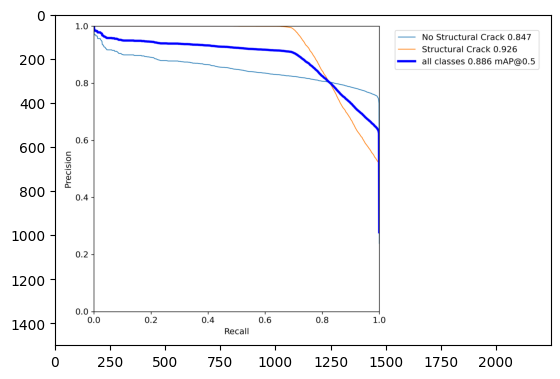

In [31]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/train/YOLOv7 1 Epoch Training Results/PR_curve.png')
plt.imshow(img)
plt.axis('off')
plt.show()

### PR Curve Results Evaluation 
The models PR Curve suggests that the model is peforming very good precision across all recalls. It shows a slight decent at around 0.7 for all classes simular to the previous epochs done for both YOLOv8 and YOLOv7.But something to point out is the Structural Crack class performs excellently from 0.0 to 0.7 staying very consistant across at a precision of 1.0, meaning the model is at its best precision at these recalls.

## 10 EPOCH Training

In [ ]:
!python train.py --batch-size 5 --img 540 540 --data E:/FinalYearProject.v3i.yolov7pytorch/data.yaml --weights yolov7.pt --device 0 --epochs 10

I decreased the batch size to 5 on for 10 epoch training and did't want to go any lower because it may make the model perform worse overall. 5 batch size was only done purely to reduce the training time. Image size also was reduce to help with reducing training time.

## 10 EPOCH Structural Crack Detection

In [3]:
!python detect.py --weights "C:/00FinalYearProject/yolov7/runs/train/YOLOv7 10 Epoch Training Results/weights/best.pt" --conf 0.25 --img-size 1280 --source "C:/00FinalYearProject/yolov7/runs/train/YOLOv7 10 Epoch Training Results/weights/best.pt" --conf 0.30 --img-size 1280 --source "C:/Users/aaron/OneDrive/Desktop/Detection Videos and Images" --name detection

Namespace(weights=['C:/00FinalYearProject/yolov7/runs/train/YOLOv7 10 Epoch Training Results/weights/best.pt'], source='C:/Users/aaron/OneDrive/Desktop/Detection Videos and Images', img_size=1280, conf_thres=0.3, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='detection', exist_ok=False, no_trace=False)
Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

3 No Structural Cracks, 1 Structural Crack, Done. (68.6ms) Inference, (123.6ms) NMS
 The image with the result is saved in: runs\detect\detection5\Detection Image 1.jpg
1 No Structural Crack, Done. (70.6ms) Inference, (1.0ms) NMS
 The image with the result is saved in: runs\detect\detection5\Detection Image 2.jpg
4 No Structural Cracks, Done. (68.2ms) Inference, (1.0ms) NMS
 Th

YOLOR  v0.1-128-ga207844 torch 2.2.0+cu118 CUDA:0 (NVIDIA GeForce GTX 1080 Ti, 11263.875MB)

c:\Users\aaron\.conda\envs\myenv\Lib\site-packages\torch\functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ..\aten\src\ATen\native\TensorShape.cpp:3550.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
Model Summary: 306 layers, 36485311 parameters, 6194944 gradients, 103.2 GFLOPS


Same reason for 5 Epochs, I have the confidence interval low just so the detections are more visable, there still accurate and effective enough and works out better then bearly seeing any detections due to how small those detections are.

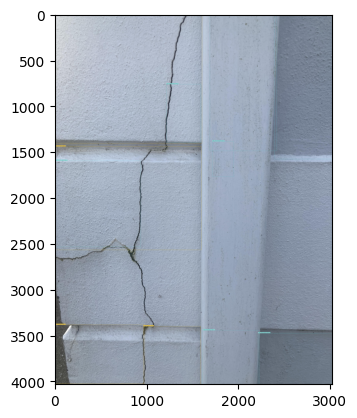

In [6]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/detect/10 Epoch Detection YOLOv7/MICA Crack detection 1.jpg')
plt.imshow(img)
plt.axis('off')
plt.show()

## 10 EPOCHS Results and Evaluation

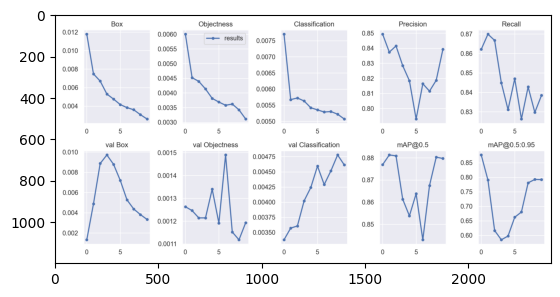

In [9]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/train/YOLOv7 10 Epoch Training Results/results.png')
plt.imshow(img)
plt.axis('off')
plt.show()

### Training Results Evaluation and Comparision
The loss metrics from this model show general downward trend for both train and validation meaning that the model is slowly improving in predicting bounding boxes, objects within bounding boxes and classifications. The performance metrics, precision is fluctuating but eventually increases back up to a high precision. Recall metric is quite volatile with the model spiking up and down indicating that the model is inconsistent to detect all objects. Noth of the mAP metrics show a decrease in precision but eventually pick up in the later epochs and the metrics increase. 

Comparing to the YOLOv8 10 epoch model, the YOLOv7 model is a lot more volatile than the YOLOv8 model. However, the training results are similar. Both models showed that they were learning and improving but both are showing no signs of convergence. And due to the computational limitation’s convergence cannot be met as it would take too long to do so. 

### F1 Score and Confidence Curve

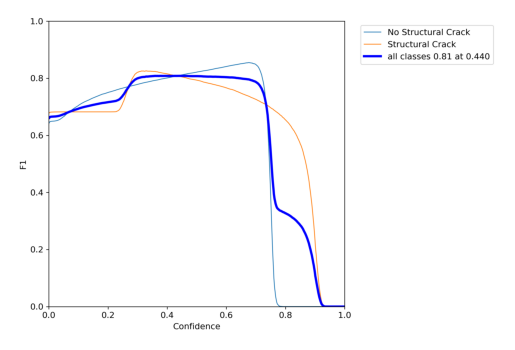

In [21]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/train/YOLOv7 10 Epoch Training Results/F1_Curve.png')
plt.imshow(img)
plt.axis('off')
plt.show()

### F1 Curve Evaluation and Comparision

The F1-Confidence curve for all classes peaks at 0.81 F1-score at 0.44 confidence levels, this is slightly worse than the YOLOv8 10 epoch model which all classes where 0.83 at a confidence interval of 0.410. The model does stay at a consistently high F1-score through the confidence levels but compared to the YOLOv8 model this model drops off for the Structural Crack class at a lower confidence level meaning that the YOLOv8 model is more precise for detecting structural cracks. 

### Confusion Matrix

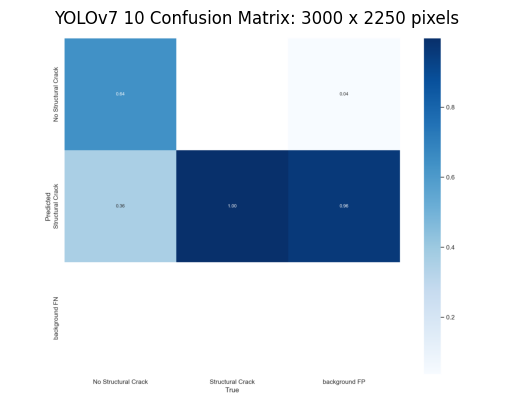

In [20]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/train/YOLOv7 10 Epoch Training Results/confusion_matrix.png')
size = (3000, 2250)

resized_img = img.resize(size, Image.Resampling.LANCZOS)
plt.imshow(resized_img)
plt.title(f'YOLOv7 10 Confusion Matrix: {img.size[0]} x {img.size[1]} pixels')  # Adds the image size to the plot title
plt.axis('off')
plt.show()


### Confusion Matrix Evaluation and Comparision
10 EPOCHs there is high for true positives for structural crack and is good but not as good for non-structural crack. This indicates that the model is has good predicitive capabilities. 

Compared to the YOLOv8 10 Epochs the it struggles wuth distinguishing Structural crack with background which YOLOv8 struggles with the opposite(distinguishing no structural crack). Both models perform simular when predicting a structural crack to be true.

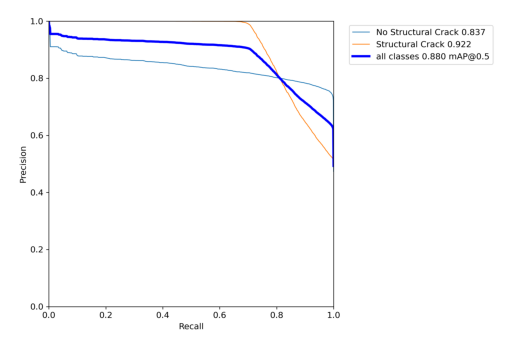

In [23]:
img = Image.open('C:/00FinalYearProject/yolov7/runs/train/YOLOv7 10 Epoch Training Results/PR_Curve.png')
plt.imshow(img)
plt.axis('off')
plt.show()

### PR Curve Evaluation and Comparision

The model shows that its precision stays stable at a high level throughout all levels of recall, indicating that the model is precise and consistent overall. The YOLOv7 model seems to perform identical to YOLOv8 in precision and recall meaning the higher the epochs YOLOv7 reaches the better it performs meaning it will scale well at the higher epochs like YOLOv8.

# Final Results Interpretation
Although there is evidence that the model is learning simular with YOLOv8, the model has not yet met convergence due to the model being unstable at times during training and is even more unstable then YOLOv8. This is  were there is spikes in validation loss and variability in the performance metrics. For a model to meet convergence the loss should be lower to a point of stability and the performance metrics also reach that level of consistency that is acceptable level of performance. Overall the YOLOv7 model performe worse in detections and all the metrics evaluated apart from the 1 Epoch metrics. This could indicate that the YOLOv8 model is learning faster and scaling better than YOLOv7. Overall the model perform accurate and effecient structural crack detection but lacked a small bit of scalabilty.